# Análisis Exploratorio 4: Cursos

EN DESARROLLO.  

Falta: histograma de porcentajes de deserción y aprobados.  

Falta: pairs plot para ver algunas posibles funciones para la regresión.  

Falta: boxplot por materia con niveles de deserción y de aprobación.  

Falta: sala temporal.

Conjunto de datos: cada observación es un curso.

In [37]:
import pandas as pd
import numpy as np
import seaborn as sns
sns.set_palette("colorblind")

# %matplotlib inline
# import matplotlib
# matplotlib.use("pgf")
# matplotlib.rcParams.update({
#     "pgf.texsystem": "pdflatex",
#     'font.family': 'serif',
#     'text.usetex': True,
#     'pgf.rcfonts': False,
# })
import matplotlib.pyplot as plt

from ydata_profiling import ProfileReport

# Flag for showing plots or saving to pgf
show = 1

In [16]:
df = pd.read_csv("../datos/dataset_04-feateng-cursos.csv")
df['SEDE'] = df['SEDE'].astype('str')
df['MATERIA'] = df['MATERIA'].astype('str')
df['cuat'] = df['cuat'].astype('str')
df['sala'] = df['sala'].astype('str')
print("Cantidad de cursos:", len(df))

Cantidad de cursos: 2664


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2664 entries, 0 to 2663
Data columns (total 20 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   anio           2664 non-null   int64  
 1   cuat           2664 non-null   int64  
 2   SEDE           2664 non-null   object 
 3   MATERIA        2664 non-null   object 
 4   curso          2664 non-null   int64  
 5   turno          2664 non-null   object 
 6   n_alum         2664 non-null   int64  
 7   p_ext          2664 non-null   float64
 8   p_recursa      2664 non-null   float64
 9   sala           2664 non-null   int64  
 10  pa1_prom       1865 non-null   float64
 11  pa2_prom       1763 non-null   float64
 12  final_prom     943 non-null    float64
 13  prom_edad      2664 non-null   float64
 14  abandona1_p    2664 non-null   float64
 15  abandona2_p    1865 non-null   float64
 16  valido1        2664 non-null   int64  
 17  valido2        2664 non-null   int64  
 18  aprueba_

In [6]:
# Descomentar para generar el reporte completo en html.
# df2 = df.loc[(df['valido1']==1) & (df['valido2']==1)]
# profile = ProfileReport(df2, title="Análisis exploratorio 3 - Solo cursos válidos")
# profile.to_file("eda_reporte_04_cursos.html")

In [7]:
################################################
#
# Cantidad de cursos
#
# por sede, por materia
# por turno por sede
#
################################################

# Ordeno las sedes por cantidad total de estudiantes
cursos = df.groupby(by=['SEDE'], as_index = False).size()
cursos.columns = ['SEDE', 'total']
cursos.sort_values(by='total', ascending=False, ignore_index=True, inplace=True)

In [8]:
materias1 = df.groupby(by=['SEDE','MATERIA'], as_index = False).size()
materias1 = materias1.pivot(index='SEDE', columns='MATERIA', values='size')
materias = pd.merge(
    cursos,
    materias1,
    how="outer",
    on='SEDE',
)
porturno = df.groupby(by=['SEDE','turno'], as_index = False).size()
porturno = porturno.pivot(index='SEDE', columns='turno', values='size')
porturno = pd.merge(
    materias.SEDE,
    porturno,
    how="outer",
    on='SEDE',
)
materias = pd.concat([materias, porturno.drop('SEDE', axis=1)], axis=1)
materias.fillna(value=0, inplace=True)
materias = materias.astype('int')
materias['SEDE'] = materias['SEDE'].astype('str')
materias

,SEDE,total,3,53,A,B,C,D
0,2,493,190,303,130,120,188,55
1,1,387,128,259,100,121,117,49
2,4,385,111,274,88,91,148,58
3,5,335,114,221,103,87,100,45
4,10,324,40,284,67,89,127,41
5,6,216,86,130,55,51,70,40
6,15,85,85,0,34,51,0,0
7,28,72,10,62,4,18,50,0
8,14,72,23,49,35,1,28,8
9,33,48,18,30,21,9,18,0


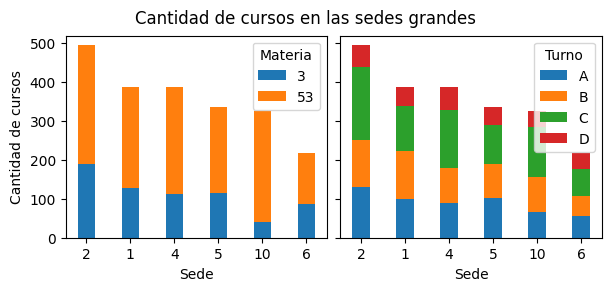

In [9]:
# Hay SEDES principales con la mayor cantidad de cursos
grandes = materias[0:6]
sedes = grandes['SEDE'].values
mat = {
    "3": np.array(grandes['3'].values),
    "53": np.array(grandes['53'].values),
}
width = 0.4

fig, ax = plt.subplots(1, 2, figsize=(9, 3), sharey=True, layout='constrained')
bottom = np.zeros(6)

for boolean, cant in mat.items():
    p = ax[0].bar(sedes, cant, width, label=boolean, bottom=bottom)
    bottom += cant

ax[0].set_xlabel("Sede")
ax[0].legend(loc="upper right", title='Materia')

turno = {
    "A": np.array(grandes['A'].values),
    "B": np.array(grandes['B'].values),
    "C": np.array(grandes['C'].values),
    "D": np.array(grandes['D'].values),
}

bottom = np.zeros(6)
for boolean, cant in turno.items():
    p = ax[1].bar(sedes, cant, width, label=boolean, bottom=bottom)
    bottom += cant

ax[1].set_xlabel("Sede")
ax[1].legend(loc="upper right", title='Turno')

ax[0].set_ylabel('Cantidad de cursos')
fig.suptitle('Cantidad de cursos en las sedes grandes')

if show:
    fig.set_size_inches(w=6, h=2.8)
    plt.show()
else:
    fig.set_size_inches(w=6, h=2.9)
    plt.savefig('../img/eda_03_sedes-cursos.pgf')

In [25]:
df2 = df.loc[(df['valido1']==1) & (df['valido2']==1)].copy()
df2 = df2.drop(['valido1', 'valido2'], axis=1)
df2.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 1763 entries, 0 to 2663
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   anio           1763 non-null   int64  
 1   cuat           1763 non-null   object 
 2   SEDE           1763 non-null   object 
 3   MATERIA        1763 non-null   object 
 4   curso          1763 non-null   int64  
 5   turno          1763 non-null   object 
 6   n_alum         1763 non-null   int64  
 7   p_ext          1763 non-null   float64
 8   p_recursa      1763 non-null   float64
 9   sala           1763 non-null   object 
 10  pa1_prom       1763 non-null   float64
 11  pa2_prom       1763 non-null   float64
 12  final_prom     942 non-null    float64
 13  prom_edad      1763 non-null   float64
 14  abandona1_p    1763 non-null   float64
 15  abandona2_p    1763 non-null   float64
 16  aprueba_p      1763 non-null   float64
 17  aprueba_rel_p  1763 non-null   float64
dtypes: float

final_prom tiene muchos faltantes, de todas formas no la voy a utilizar.

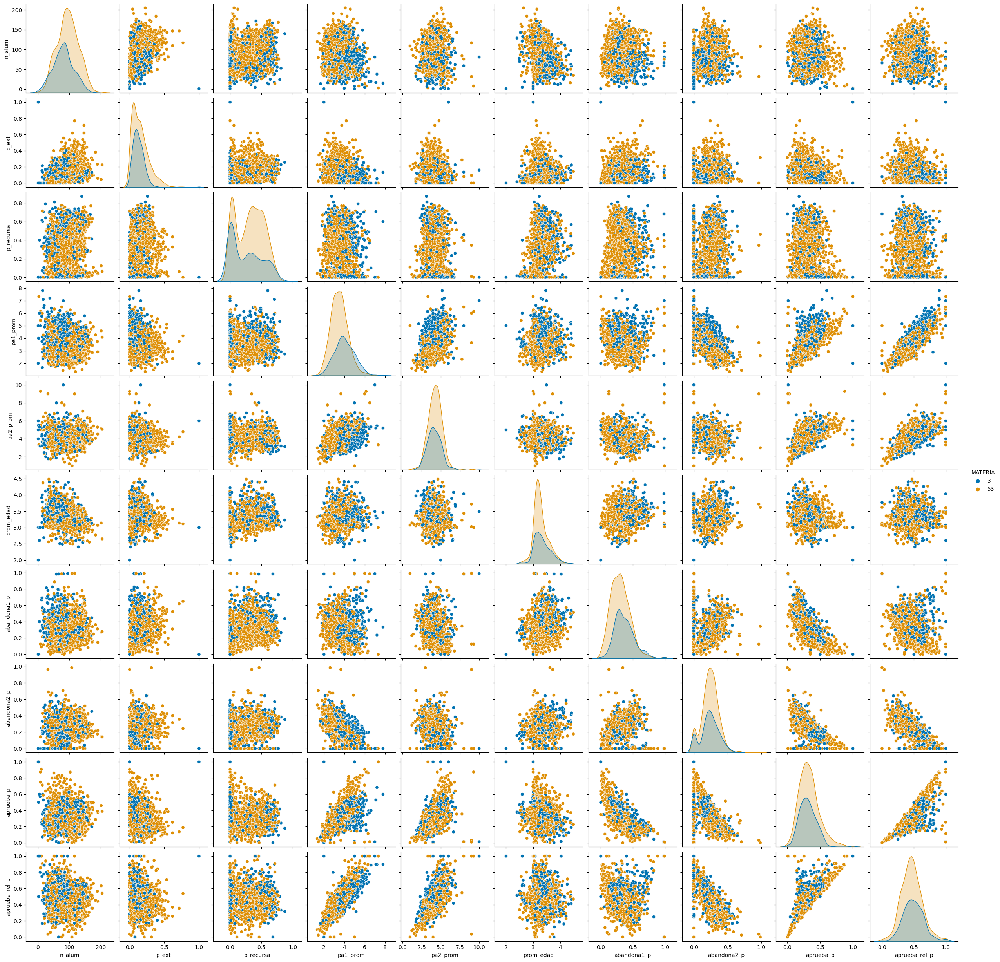

In [38]:
sns.pairplot(df2.drop(['anio', 'curso', 'final_prom'], axis=1), hue='MATERIA')


abandona2_p:  
disminuye con pa1_prom

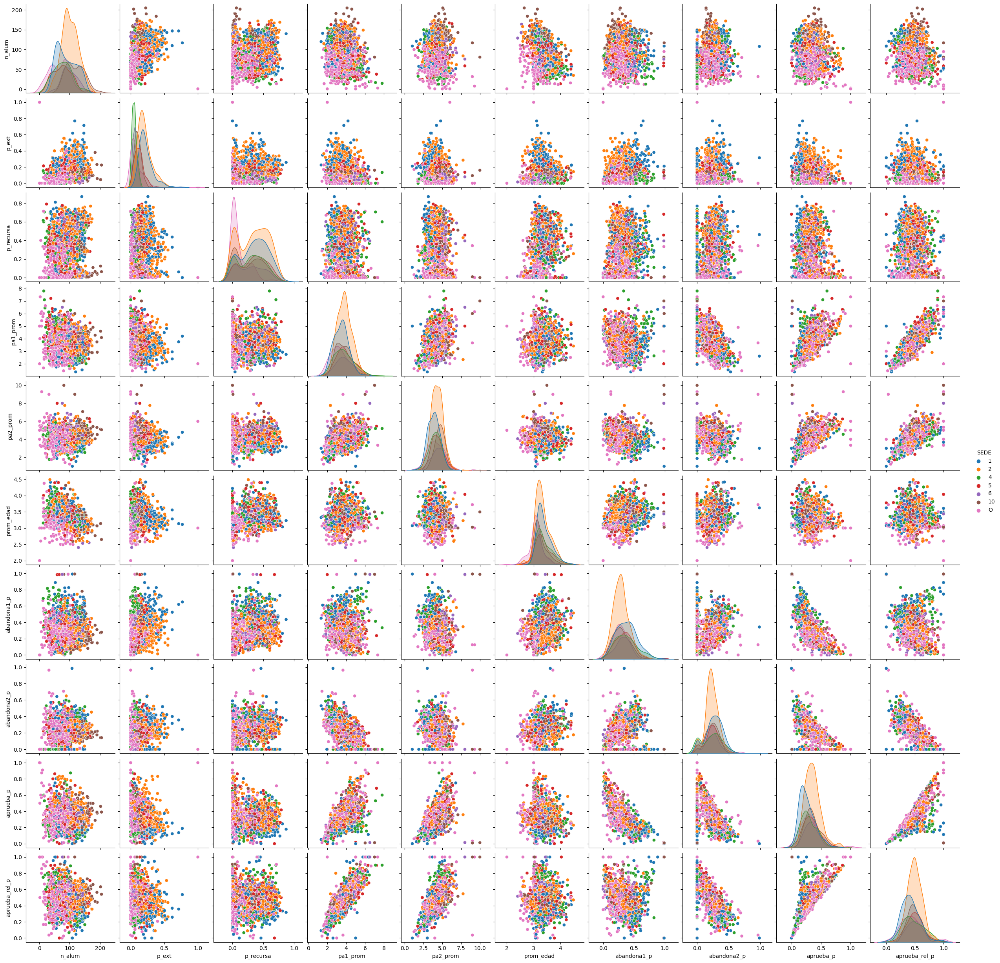

In [35]:
df3 = df2.copy()
df3.loc[~df3['SEDE'].isin(sedes), 'SEDE'] = 'O'
sns.pairplot(df3.drop(['anio', 'curso', 'final_prom'], axis=1), hue='SEDE')


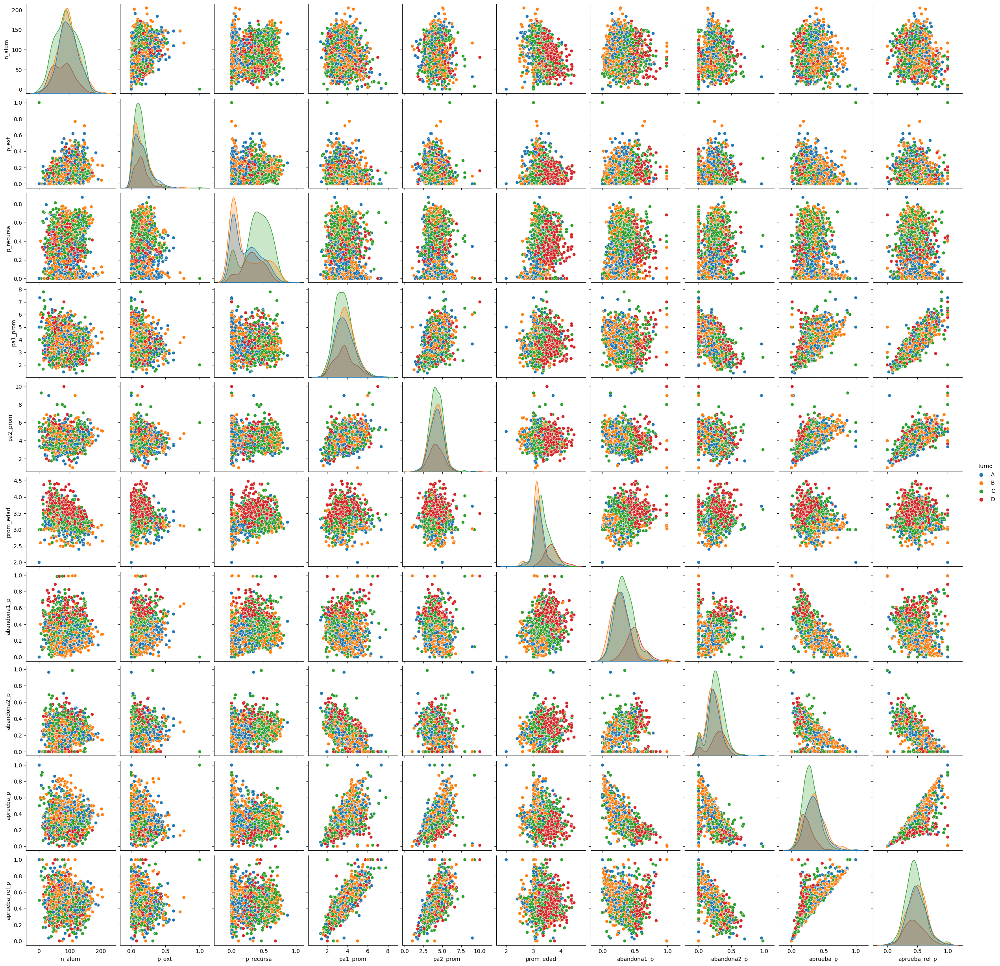

In [36]:
sns.pairplot(df2.drop(['anio', 'curso', 'final_prom'], axis=1), hue='turno')

In [10]:
salas = df['sala'].unique()

In [11]:
# Solo los cursos válidos para analizar desgranamiento.
df2 = df.loc[(df['valido1']==1) & (df['valido2']==1)].copy()
df2['num_abandona2'] = df2['abandona2_p'] * df2['n_alum']
df2['num_abandona1'] = df2['abandona1_p'] * df2['n_alum']
df2['num_permanece'] = df2['n_alum'] - df2['num_abandona1']
# Creo una categoría por anio-cuat
df2['cuatrimestre'] = df2['anio'].astype(str) + "-" + df2['cuat'].astype(str)
df2['total_abandona2'] = df2.groupby(['cuatrimestre', 'sala'])['num_abandona2'].transform('sum')
df2['total_permanece'] = df2.groupby(['cuatrimestre', 'sala'])['num_permanece'].transform('sum')
df2['total_abandona2_p'] = df2['total_abandona2'] / df2['total_permanece']
df2 = df2.drop(['num_abandona1', 'num_abandona2', 'num_permanece', 'total_abandona2',
          'total_permanece'], axis=1)
df2


,anio,cuat,SEDE,MATERIA,curso,turno,n_alum,p_ext,p_recursa,sala,...,final_prom,prom_edad,abandona1_p,abandona2_p,valido1,valido2,aprueba_p,aprueba_rel_p,cuatrimestre,total_abandona2_p
0,2011,1,1,3,0,A,71,0.070423,0.000000,10,...,4.142857,3.464789,0.380282,0.363636,1,1,0.225352,0.363636,2011-1,0.615102
1,2011,1,1,3,1,A,58,0.120690,0.000000,12,...,4.500000,3.431034,0.310345,0.250000,1,1,0.155172,0.225000,2011-1,0.580300
2,2011,1,1,3,2,B,78,0.089744,0.000000,10,...,3.846154,3.653846,0.294872,0.236364,1,1,0.294872,0.418182,2011-1,0.615102
3,2011,1,1,3,3,B,75,0.173333,0.000000,12,...,4.076923,3.453333,0.346667,0.224490,1,1,0.266667,0.408163,2011-1,0.580300
4,2011,1,1,3,4,C,42,0.166667,0.000000,10,...,3.625000,3.690476,0.285714,0.333333,1,1,0.261905,0.366667,2011-1,0.615102
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2658,2019,2,31,3,2642,A,19,0.000000,0.105263,139,...,3.800000,2.684211,0.210526,0.200000,1,1,0.368421,0.466667,2019-2,0.237500
2659,2019,2,28,53,2637,B,40,0.025000,0.425000,133,...,4.000000,2.750000,0.275000,0.310345,1,1,0.350000,0.482759,2019-2,0.401763
2661,2019,2,30,53,2641,B,34,0.000000,0.058824,138,...,2.666667,2.558824,0.411765,0.100000,1,1,0.441176,0.750000,2019-2,0.170000
2662,2019,2,27,3,2636,B,5,0.000000,0.400000,125,...,3.500000,2.600000,0.400000,0.000000,1,1,0.600000,1.000000,2019-2,0.000000


In [12]:
# Ejemplo de una sala:
df2.loc[df2['sala'] == 51,['cuatrimestre', 'MATERIA', 'turno', 'n_alum', 'sala', 'total_abandona2_p']]

,cuatrimestre,MATERIA,turno,n_alum,sala,total_abandona2_p
1715,2016-2,3,C,141,51,0.221155
1834,2017-1,3,C,134,51,0.690844
2122,2018-1,3,C,111,51,0.512465
2285,2018-2,53,A,167,51,0.383303
2286,2018-2,53,B,165,51,0.383303
2421,2019-1,3,C,153,51,0.552875
2523,2019-2,53,B,163,51,0.379340
2524,2019-2,53,C,163,51,0.379340
2529,2019-2,53,A,160,51,0.379340


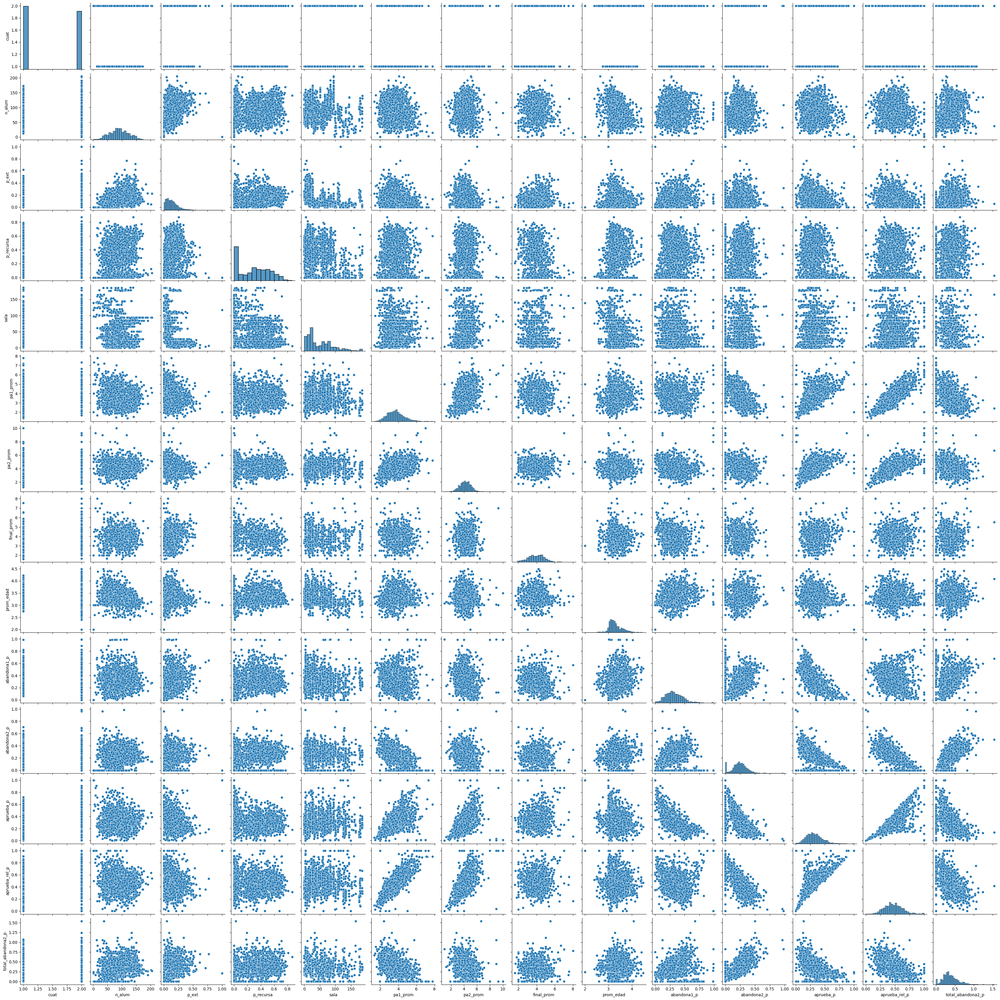

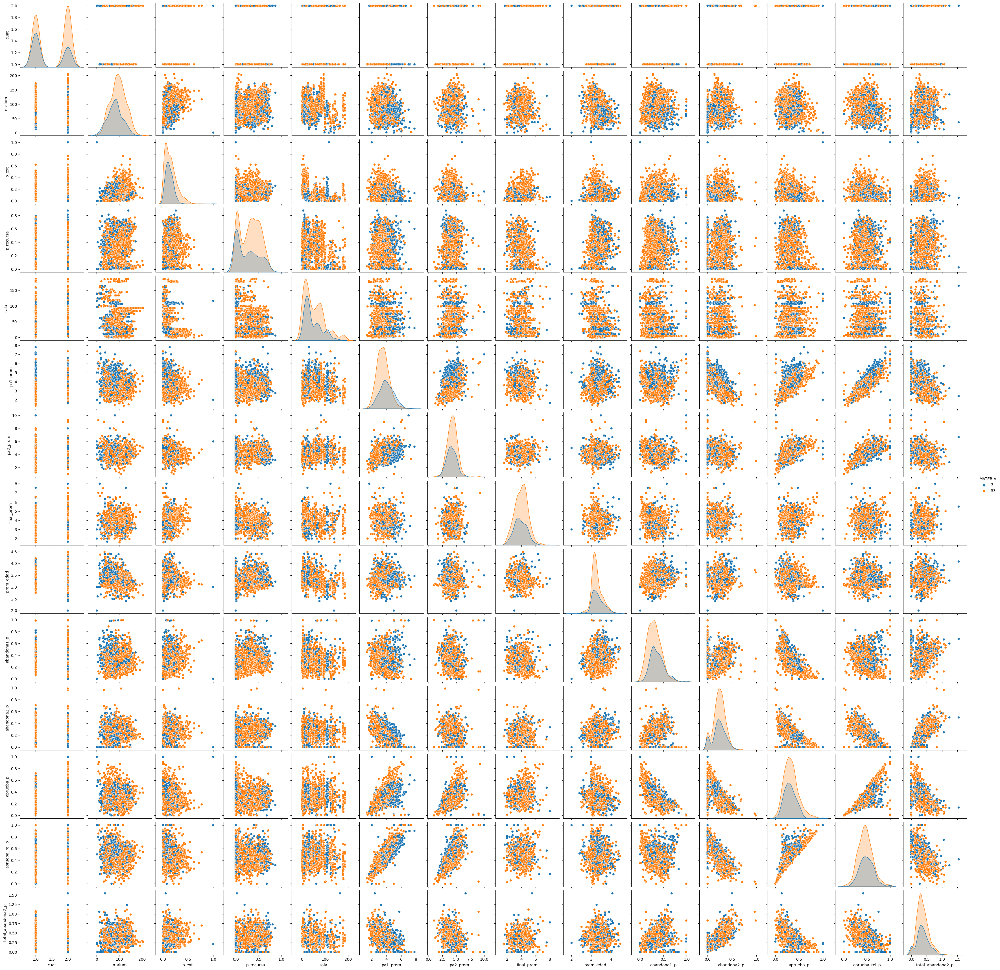

In [19]:
sns.pairplot(df2.drop(['anio', 'curso', 'cuatrimestre', 'valido1', 'valido2'], axis=1), hue='MATERIA')


In [13]:
##########################
#
# salas
#
##########################
df_salas = df2[['cuatrimestre', 'SEDE', 'MATERIA', 'sala', 'total_abandona2_p']].copy()
df_salas = df_salas.drop_duplicates(ignore_index=True)


In [14]:
df_salas

,cuatrimestre,SEDE,MATERIA,sala,total_abandona2_p
0,2011-1,1,3,10,0.615102
1,2011-1,1,3,12,0.580300
2,2011-1,1,3,3,0.410019
3,2011-1,1,53,4,0.382514
4,2011-1,1,53,5,0.354662
...,...,...,...,...,...
916,2019-2,21,53,120,0.409912
917,2019-2,2,53,18,0.420719
918,2019-2,31,3,139,0.237500
919,2019-2,30,53,138,0.170000
